In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from scipy import signal
from scipy.ndimage import maximum_filter, generate_binary_structure
from utils import *

In [6]:
def harris(I, N=100, **kwargs):
    param = {
        'disp': False,
        'N': N,
        'thresh': 0,
        'hsize': 3,
        'sigma': 0.5,
        'eig': False,
        'tile': [3,3],
        'mask': None,
        'fft': False,
    }
    param.update(kwargs)

    I = I.astype(np.float64)

    nr, nc = I.shape

    # Create gradient masks
    dx = np.array([[-1, 0, 1],
                   [-1, 0, 1],
                   [-1, 0, 1]], dtype=np.float64) / 3

    dy = dx.T

    # Calculate image gradients
    Ix = signal.convolve2d(I, dx, boundary='symm', mode='same')
    Iy = signal.convolve2d(I, dy, boundary='symm', mode='same')

    # Calculate gradient products
    IxIx = Ix * Ix
    IyIy = Iy * Iy
    IxIy = Ix * Iy

    # Smooth squared image gradients
    hsize = param['hsize']
    sigma = param['sigma']

    gmask = gaussian_kernel(hsize, sigma)

    if not param['fft']:
        IxIx = signal.convolve2d(IxIx, gmask, boundary='symm', mode='same')
        IyIy = signal.convolve2d(IyIy, gmask, boundary='symm', mode='same')
        IxIy = signal.convolve2d(IxIy, gmask, boundary='symm', mode='same')
    else:
        # Perform convolution in frequency domain
        m = IxIx.shape[0] + gmask.shape[0] - 1
        n = IxIx.shape[1] + gmask.shape[1] - 1
        G = np.fft.fft2(gmask, s=(m,n))
        IxIx = np.real(np.fft.ifft2(np.fft.fft2(IxIx, s=(m,n)) * G))
        IyIy = np.real(np.fft.ifft2(np.fft.fft2(IyIy, s=(m,n)) * G))
        IxIy = np.real(np.fft.ifft2(np.fft.fft2(IxIy, s=(m,n)) * G))
        # Keep 'same' portion
        w = (hsize - 1) // 2  # hsize is assumed to be odd
        IxIx = IxIx[w:w+nr, w:w+nc]
        IyIy = IyIy[w:w+nr, w:w+nc]
        IxIy = IxIy[w:w+nr, w:w+nc]

    # Calculate the eigenvalues
    B = IxIx + IyIy
    sqrt_term = np.sqrt(B**2 - 4*(IxIx * IyIy - IxIy**2))
    lambda1 = (B + sqrt_term) / 2
    lambda2 = (B - sqrt_term) / 2

    # Corner response function
    if param['eig']:
        # Minimum eigenvalue
        R = np.minimum(lambda1, lambda2)
    else:
        # Harris corner response function
        R = lambda1 * lambda2 - 0.04 * (lambda1 + lambda2)**2

    # Apply mask if provided
    if param['mask'] is not None:
        mask = param['mask']
        if mask.shape != R.shape:
            raise ValueError("Mask must be the same size as the image.")
    else:
        mask = np.ones_like(R, dtype=bool)

    # Find local maxima
    neighborhood = generate_binary_structure(2, 2)
    local_max = (R == maximum_filter(R, footprint=neighborhood))
    Maxima = (local_max & mask)
    Maxima_R = Maxima * R

    # Get indices where Maxima > thresh
    indices = np.argwhere(Maxima_R > param['thresh'])
    m_values = Maxima_R[indices[:,0], indices[:,1]]

    # Sort interest points by response function
    sorted_indices = np.argsort(m_values)
    # Flip so largest response points are first
    sorted_indices = sorted_indices[::-1]

    i = indices[sorted_indices,0]
    j = indices[sorted_indices,1]
    m = m_values[sorted_indices]

    # Process image regionally
    tile = param['tile']
    if tile[0] > 1 and tile[1] > 1:
        ii = []
        jj = []
        mm = []
        Npts_per_region = int(round(param['N'] / (tile[0]*tile[1])))
        xx = np.round(np.linspace(0, nc, tile[1]+1)).astype(int)
        yy = np.round(np.linspace(0, nr, tile[0]+1)).astype(int)
        for pp in range(1, len(xx)):
            idx = np.where((j >= xx[pp-1]) & (j < xx[pp]))[0]
            for qq in range(1, len(yy)):
                idy = np.where((i >= yy[qq-1]) & (i < yy[qq]))[0]
                ind = np.intersect1d(idx, idy)
                ind = ind[:min(len(ind), Npts_per_region)]
                ii.extend(i[ind])
                jj.extend(j[ind])
                mm.extend(m[ind])
        ii = np.array(ii)
        jj = np.array(jj)
        mm = np.array(mm)
    else:
        ii = i[:param['N']]
        jj = j[:param['N']]
        mm = m[:param['N']]


    if param['disp']:
        # Overlay corner points on original image
        plt.figure()
        plt.imshow(I, cmap='gray')
        plt.plot(jj, ii, 'y+')
        plt.show()

    return ii, jj, mm

# GAUSSIAN KERNEL

In [7]:
def gaussian_kernel(size, sigma):
    """Generate a 2D Gaussian kernel."""
    size = int(size)
    x, y = np.mgrid[-(size//2):(size//2)+1, -(size//2):(size//2)+1]
    g = np.exp(-(x**2 + y**2)/(2*sigma**2))
    return g / g.sum()

# LOADING IMAGES

In [8]:
def load_images(path):
    """
    Load images from file paths and convert to RGB.
    """
    images = [cv2.imread(os.path.join(path, file)) for file in sorted(os.listdir(path))]
    images = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in images]

    print(f"Images loaded successfully!")
    
    fig, axs = plt.subplots(1, len(images), figsize=(24, 8))
    for i in range(len(images)):
        axs[i].imshow(images[i])  # Convert BGR to RGB
        axs[i].set_title(f'Image {i+1}')
        axs[i].axis('off')  # Turn off axis labels
    return images

# FEATURE DETECTION AND MATCHING

##### (Setting N=1500 in detect and compute keypoints function)

In [9]:
def detect_and_compute_keypoints(img):
    """
    Detect keypoints and compute descriptors for each image using SIFT.
    """
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    keypoints = []
    descriptors = []
    y, x, response = harris(gray_img, N=1500) 
    keypoints = [cv2.KeyPoint(float(xi), float(yi), 10) for xi, yi in zip(x, y)]
    keypoints, descriptors = sift.compute(gray_img, keypoints)

    return keypoints, descriptors

def match_features(des1, des2):
    """
    Match features between two sets of descriptors using BFMatcher with L2 norm and knnMatch.
    """
    bf = cv2.BFMatcher(cv2.NORM_L2)
    matches = bf.knnMatch(des1, des2, k=2)
    
    # Apply ratio test to filter good matches
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)
    
    good_matches = sorted(good_matches, key=lambda x: x.distance)
    return good_matches

def draw_matches(img1, img2, kp1, kp2, matches, num_matches=100):
    """
    Draw the top N feature matches between two images.
    """
    img_matches = cv2.drawMatches(img1, kp1, img2, kp2, matches[:num_matches], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize=(12, 6))
    plt.imshow(img_matches)
    plt.title("Top Feature Matches")
    plt.show()

# WARPING AND MASKING

In [10]:
def warpPerspectivePadded(
        src, dst, H,
        flags=cv2.INTER_LINEAR,
        borderMode=cv2.BORDER_CONSTANT,
        borderValue=0):

    assert H.shape == (3, 3), \
        'Perspective transformation shape should be (3, 3).\n' \
        + 'Use warpAffinePadded() for (2, 3) affine transformations.'

    H = H / H[2, 2]  # ensure a legal homography
    if flags in (cv2.WARP_INVERSE_MAP,
                 cv2.INTER_LINEAR + cv2.WARP_INVERSE_MAP,
                 cv2.INTER_NEAREST + cv2.WARP_INVERSE_MAP):
        H = cv2.invert(H)[1]
        flags -= cv2.WARP_INVERSE_MAP

    # it is enough to find where the corners of the image go to find
    # the padding bounds; points in clockwise order from origin
    src_h, src_w = src.shape[:2]
    lin_homg_pts = np.array([
        [0, src_w, src_w, 0],
        [0, 0, src_h, src_h],
        [1, 1, 1, 1]])

    # Transform points
    transf_lin_homg_pts = H.dot(lin_homg_pts)
    transf_lin_homg_pts /= transf_lin_homg_pts[2, :]

    # Find min and max points
    min_x = np.floor(np.min(transf_lin_homg_pts[0])).astype(int)
    min_y = np.floor(np.min(transf_lin_homg_pts[1])).astype(int)
    max_x = np.ceil(np.max(transf_lin_homg_pts[0])).astype(int)
    max_y = np.ceil(np.max(transf_lin_homg_pts[1])).astype(int)

    # Add translation to the transformation matrix to shift to positive values
    anchor_x, anchor_y = 0, 0
    transl_transf = np.eye(3, 3)
    if min_x < 0:
        anchor_x = -min_x
        transl_transf[0, 2] += anchor_x
    if min_y < 0:
        anchor_y = -min_y
        transl_transf[1, 2] += anchor_y
    shifted_transf = transl_transf.dot(H)
    shifted_transf /= shifted_transf[2, 2]

    # Create padded destination image
    dst_h, dst_w = dst.shape[:2]

    pad_widths = [anchor_y, max(max_y, dst_h) - dst_h,
                  anchor_x, max(max_x, dst_w) - dst_w]

    dst_padded = cv2.copyMakeBorder(dst, *pad_widths,
                                    borderType=borderMode, value=borderValue)

    dst_pad_h, dst_pad_w = dst_padded.shape[:2]
    src_warped = cv2.warpPerspective(
        src, shifted_transf, (dst_pad_w, dst_pad_h),
        flags=flags, borderMode=borderMode, borderValue=borderValue)

    return dst_padded, src_warped

def masking(bot, top, alpha):
    topmask, botmask = cv2.inRange(top, 0, 0), cv2.inRange(bot, 0, 0)
    # creates final mask of overlaying black pixels
    mask_bot, mask_top = (botmask != 255) & (topmask == 255), (topmask != 255) & (botmask == 255)
    blend = cv2.addWeighted(top, alpha, bot, 1-alpha, 0.0)
    blend[mask_bot] = bot[mask_bot]
    blend[mask_top] = top[mask_top]
    
    return blend

# IMAGE STITCHING

In [11]:
def stitch_images(img1, img2, kp1, kp2, matches):
    """
    Stitch two images together using matched keypoints and RANSAC to find homography.
    This version adds padding based on detected alignment (left or right).
    """
    # Extract matched keypoints
    img1_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    img2_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
    
    # Compute homography matrix using RANSAC
    H, mask = cv2.findHomography(img1_pts, img2_pts, cv2.RANSAC, 5.0)
    img1_warped, img2_padded = warpPerspectivePadded(img1, img2, H)
    stitched_image = masking(img1_warped, img2_padded, 0.5)
    result = np.uint8(stitched_image)
    
    return result

# CREATING PANORAMA

In [12]:
def create_panorama(images):
    """
    Create a panorama from a list of images.
    """
    stitched_image = images[0]  # Start with the first image
    for i in range(1, len(images)):
        print(f"Stitching image {i-1} and {i}...")
        keypoints1, descriptors1 = detect_and_compute_keypoints(stitched_image)
        keypoints2, descriptors2 = detect_and_compute_keypoints(images[i])
        
        # Match features
        matches = match_features(descriptors1, descriptors2)
        print(f"Number of good matches between stitched image and image {i}: {len(matches)}")

        draw_matches(stitched_image, images[i], keypoints1, keypoints2, matches, num_matches=30)
        
        # Stitch the current pair of images
        stitched_image = stitch_images(stitched_image, images[i], keypoints1, keypoints2, matches)
    
    return stitched_image

## 50% Overlap - Murals

Images loaded successfully!


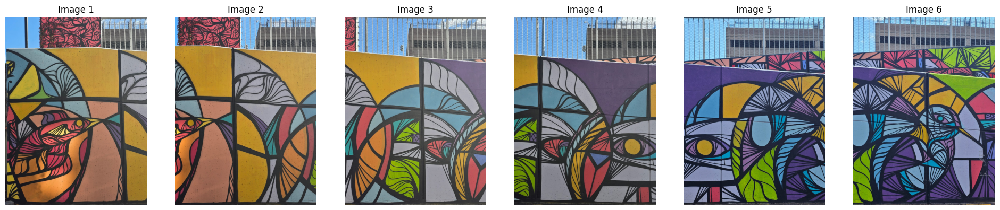

In [13]:
path_1 = "/home/sairam/Desktop/RSN/HW-ASST/ASSIGNMENTS/LAB5/50% Mural - Outside Class//"
images_1 = load_images(path_1)

Stitching image 0 and 1...


/tmp/ipykernel_18766/2371825414.py:61: RuntimeWarning: invalid value encountered in sqrt
  sqrt_term = np.sqrt(B**2 - 4*(IxIx * IyIy - IxIy**2))


Number of good matches between stitched image and image 1: 412


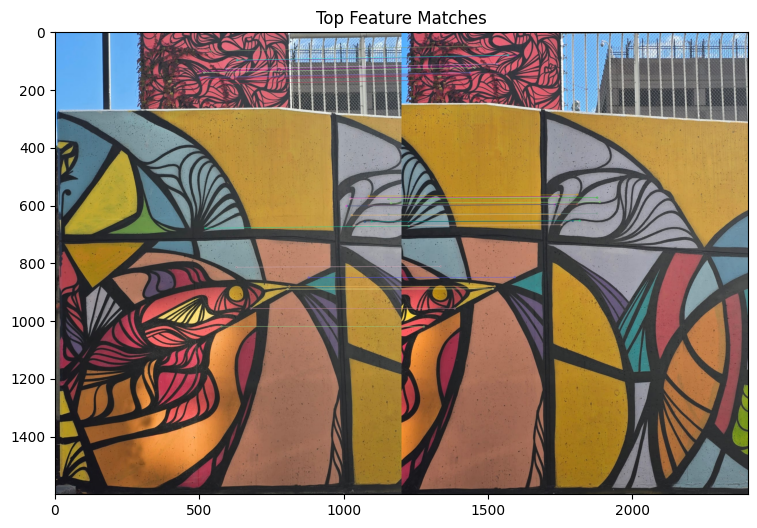

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 160


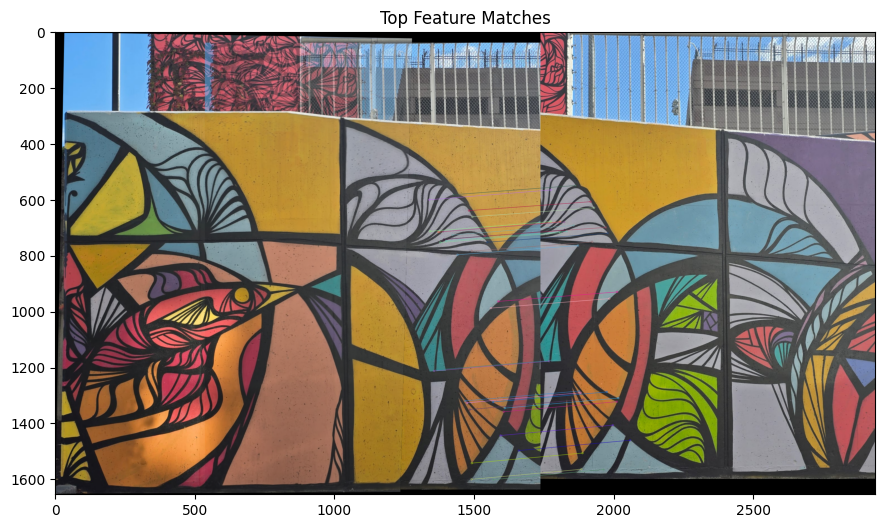

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 257


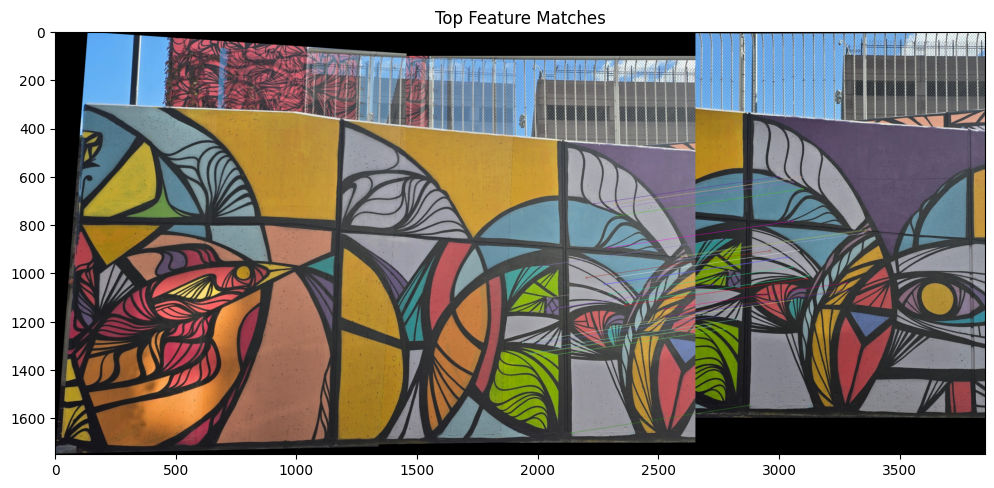

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 176


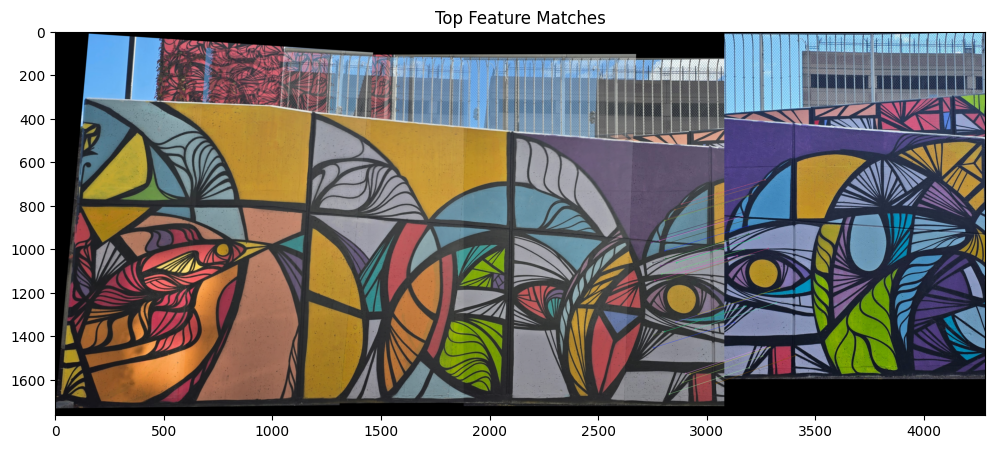

Stitching image 4 and 5...
Number of good matches between stitched image and image 5: 189


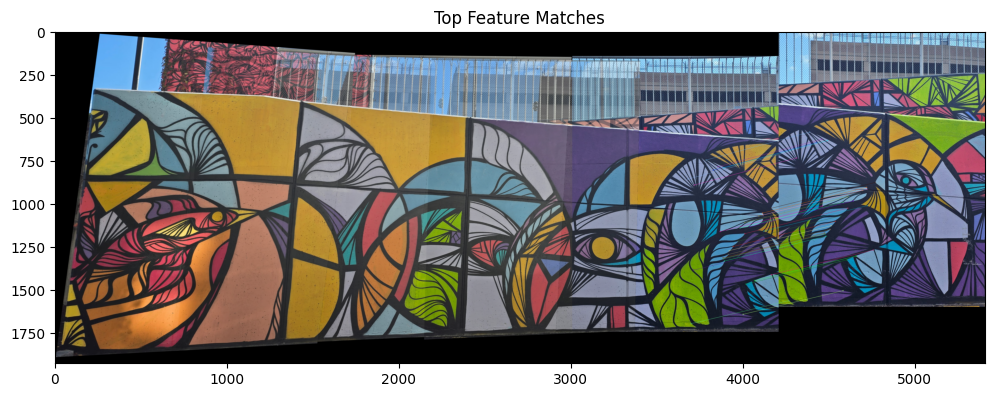

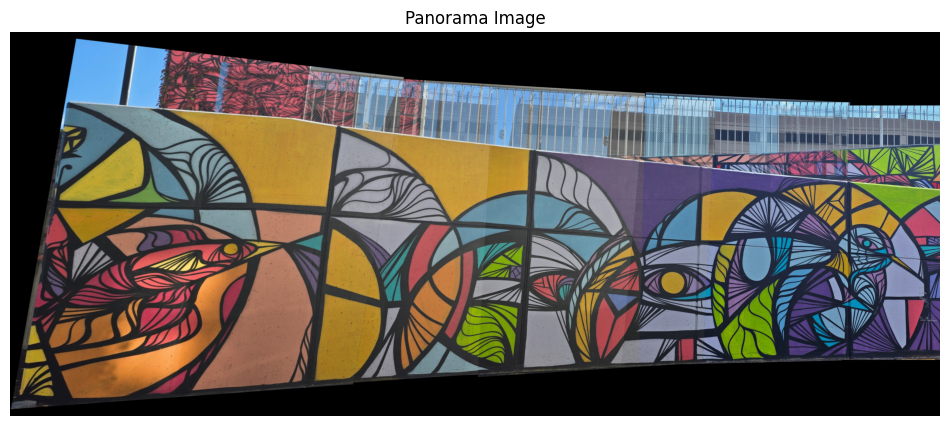

In [14]:
panorama_1 = create_panorama(images_1)

# Display the final panorama
plt.figure(figsize=(12, 10))
plt.imshow(panorama_1)
plt.title("Panorama Image")
plt.axis("off")
plt.show()

### I got the desired panorama for the mural, but the sky and building in the background was reflecting bad on the panorama, so I took pictures from another mural near ruggles with the same 50% overlap. The panorama result for that is in the following cells

Images loaded successfully!


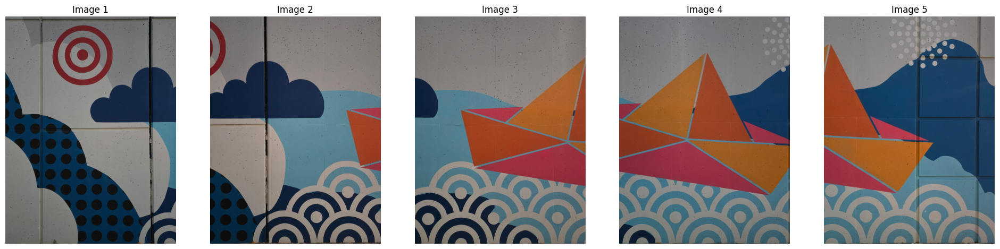

In [15]:
path_2 = "/home/sairam/Desktop/RSN/HW-ASST/ASSIGNMENTS/LAB5/50% Mural - Ruggles/"
images_2 = load_images(path_2)

Stitching image 0 and 1...


/tmp/ipykernel_18766/2371825414.py:61: RuntimeWarning: invalid value encountered in sqrt
  sqrt_term = np.sqrt(B**2 - 4*(IxIx * IyIy - IxIy**2))


Number of good matches between stitched image and image 1: 346


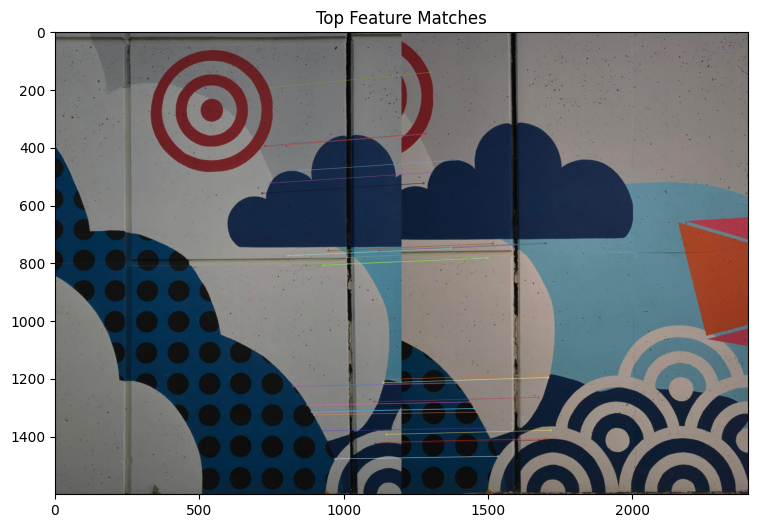

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 296


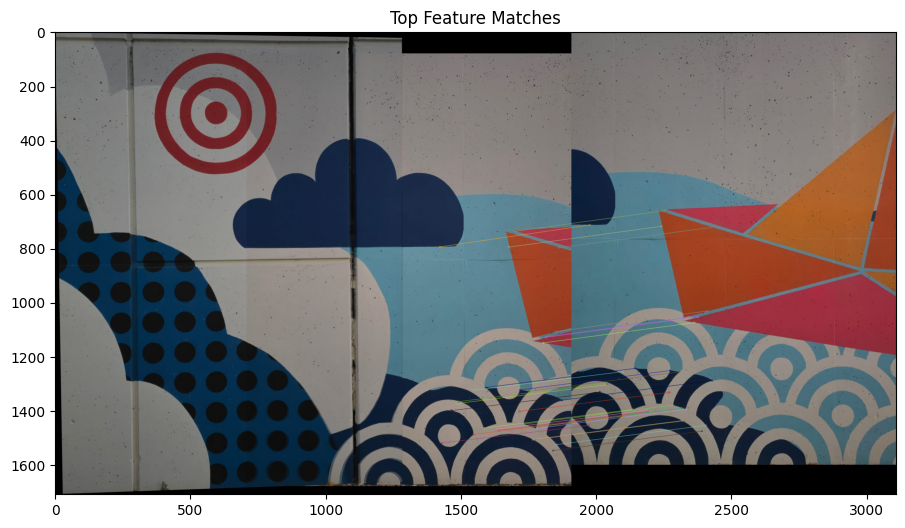

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 188


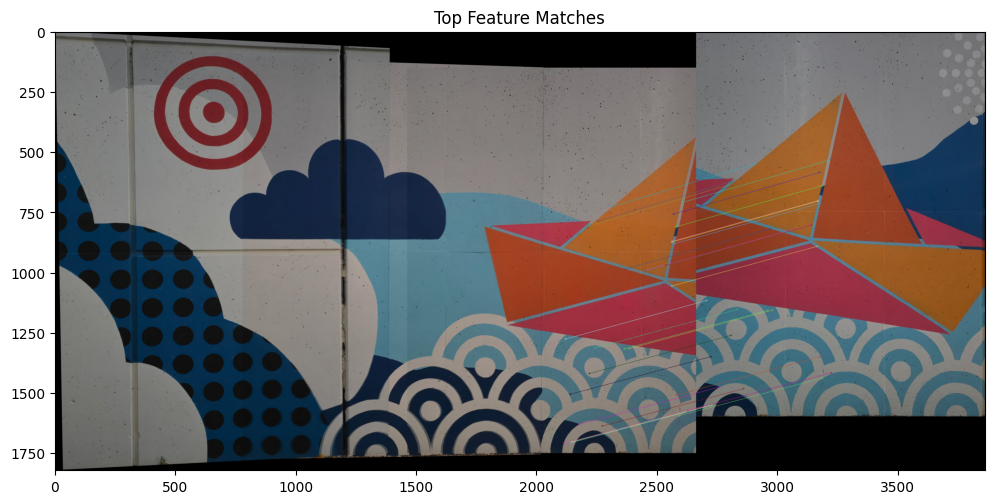

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 201


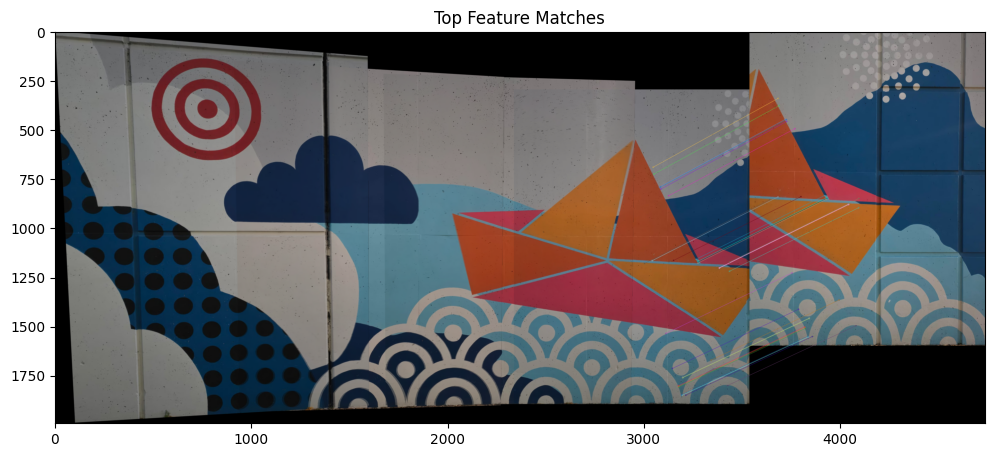

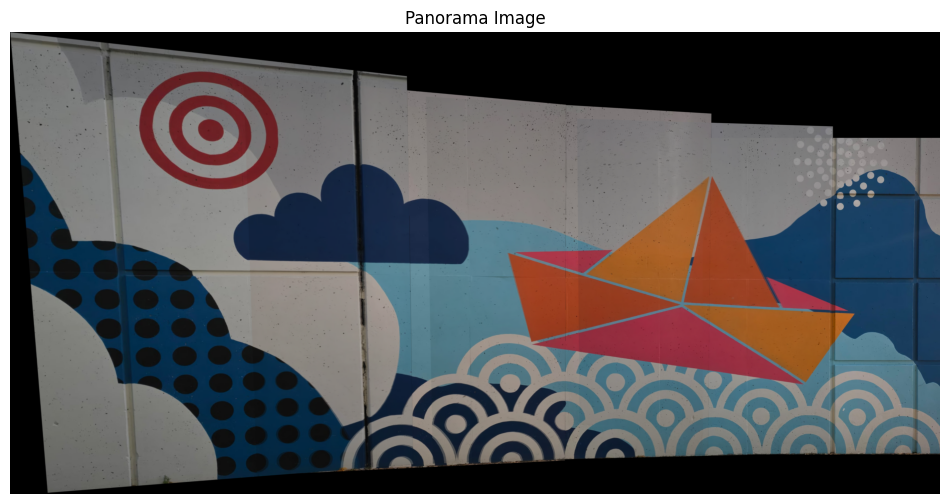

In [16]:
panorama_2 = create_panorama(images_2)

# Display the final panorama
plt.figure(figsize=(12, 10))
plt.imshow(panorama_2)
plt.title("Panorama Image")
plt.axis("off")
plt.show()

## 50% Overlap - Brick Wall

Images loaded successfully!


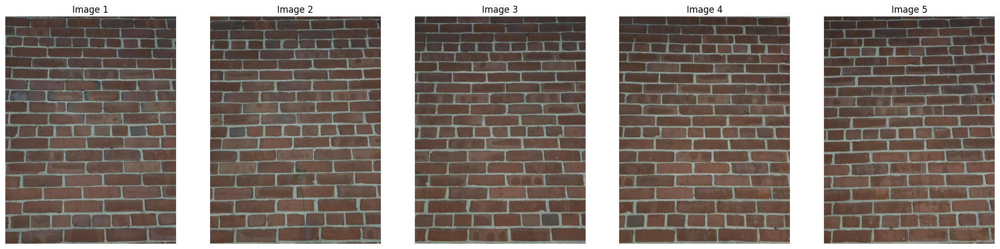

In [22]:
path_3 = "/home/sairam/Desktop/RSN/HW-ASST/ASSIGNMENTS/LAB5/50% Overlap - Brick Wall/"
images_3 = load_images(path_3)

Stitching image 0 and 1...


/tmp/ipykernel_15137/2371825414.py:61: RuntimeWarning: invalid value encountered in sqrt
  sqrt_term = np.sqrt(B**2 - 4*(IxIx * IyIy - IxIy**2))


Number of good matches between stitched image and image 1: 247


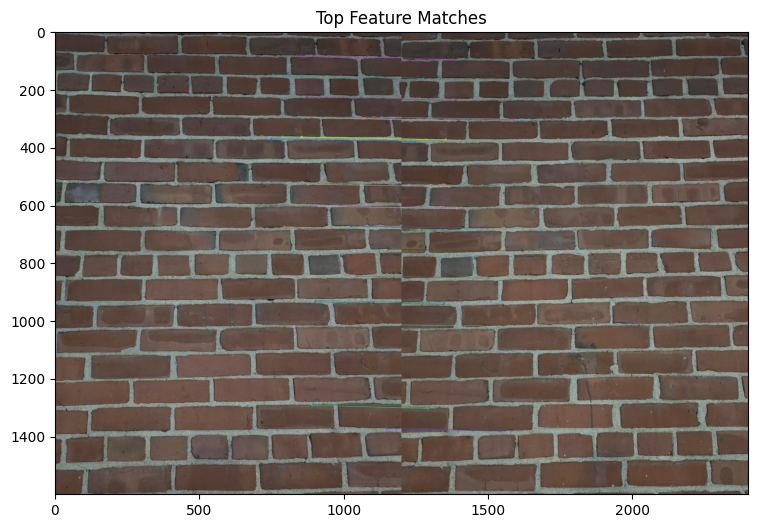

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 225


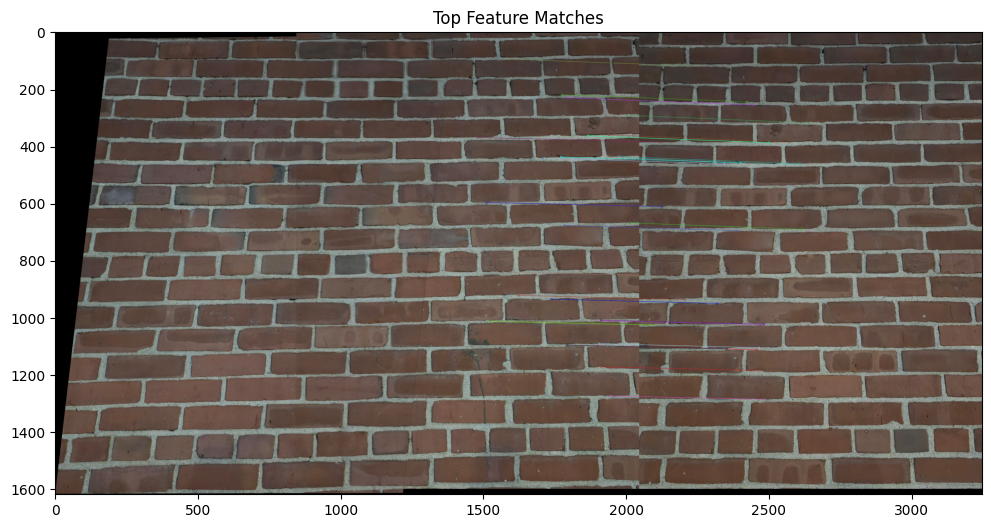

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 154


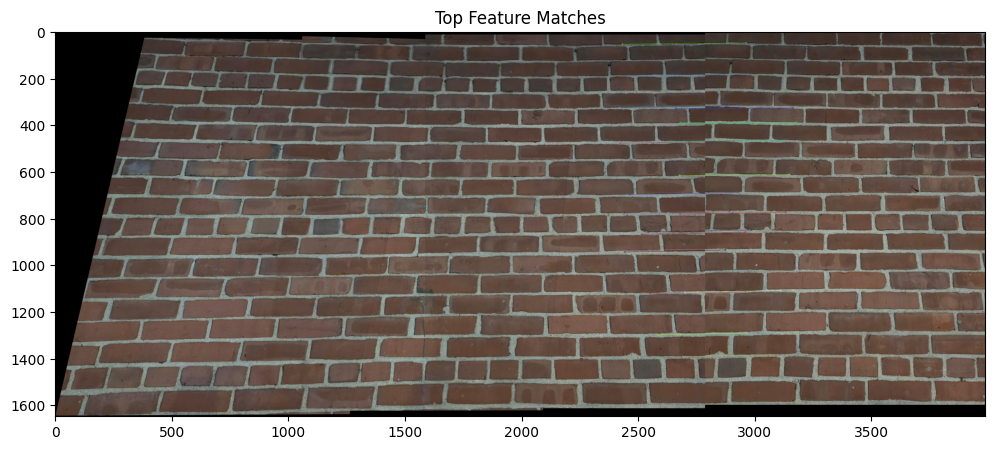

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 227


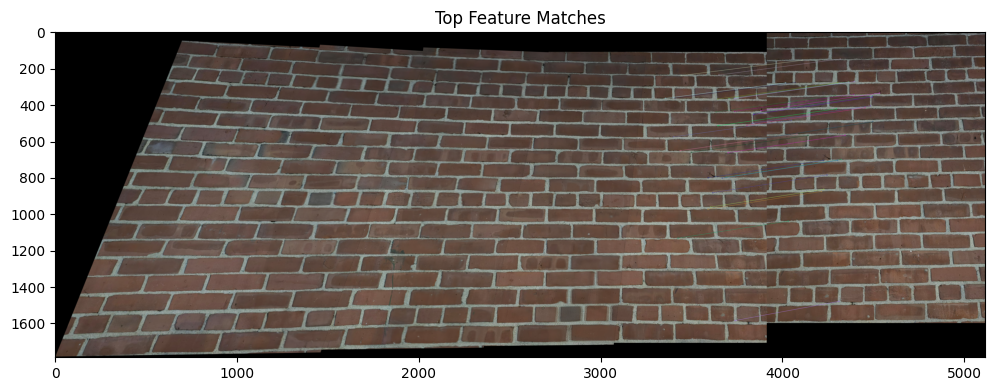

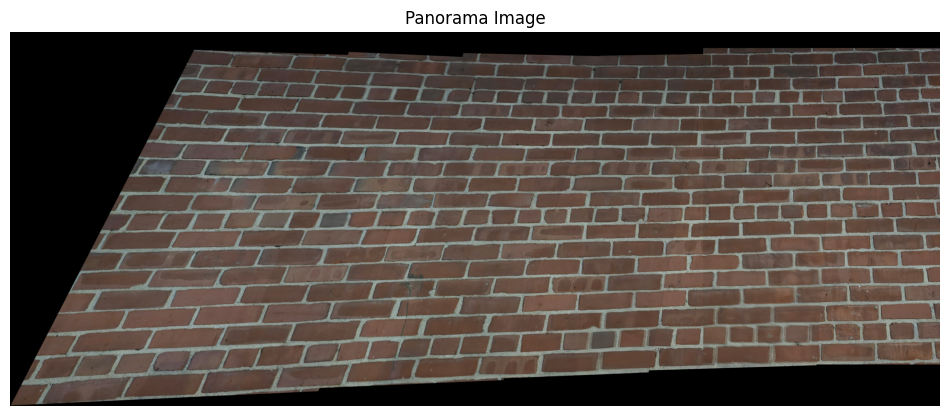

In [23]:
panorama_3 = create_panorama(images_3)

# Display the final panorama
plt.figure(figsize=(12, 10))
plt.imshow(panorama_3)
plt.title("Panorama Image")
plt.axis("off")
plt.show()

### I also tried this out on a cement wall to see how this works. The panorama result for that is below

Images loaded successfully!


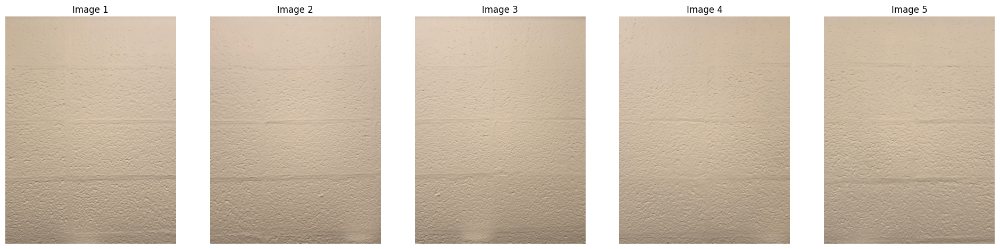

In [17]:
path_4 = "/home/sairam/Desktop/RSN/HW-ASST/ASSIGNMENTS/LAB5/50% Overlap - Cement Wall/"
images_4 = load_images(path_4)

Stitching image 0 and 1...


/tmp/ipykernel_18766/2371825414.py:61: RuntimeWarning: invalid value encountered in sqrt
  sqrt_term = np.sqrt(B**2 - 4*(IxIx * IyIy - IxIy**2))


Number of good matches between stitched image and image 1: 174


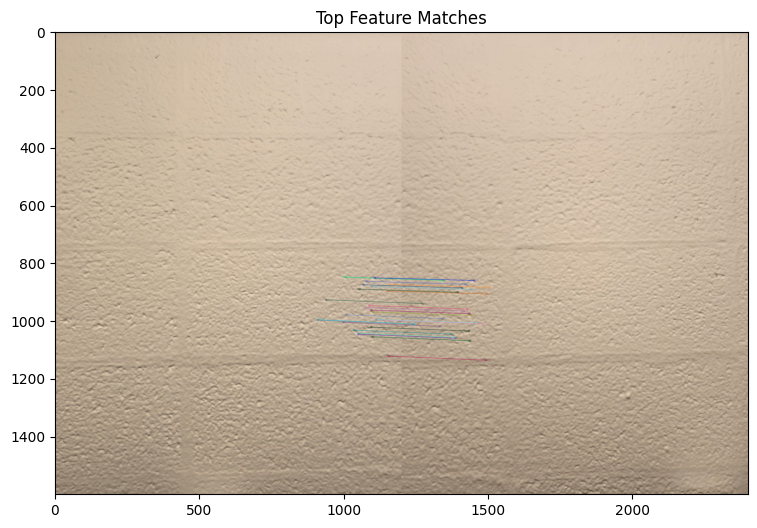

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 243


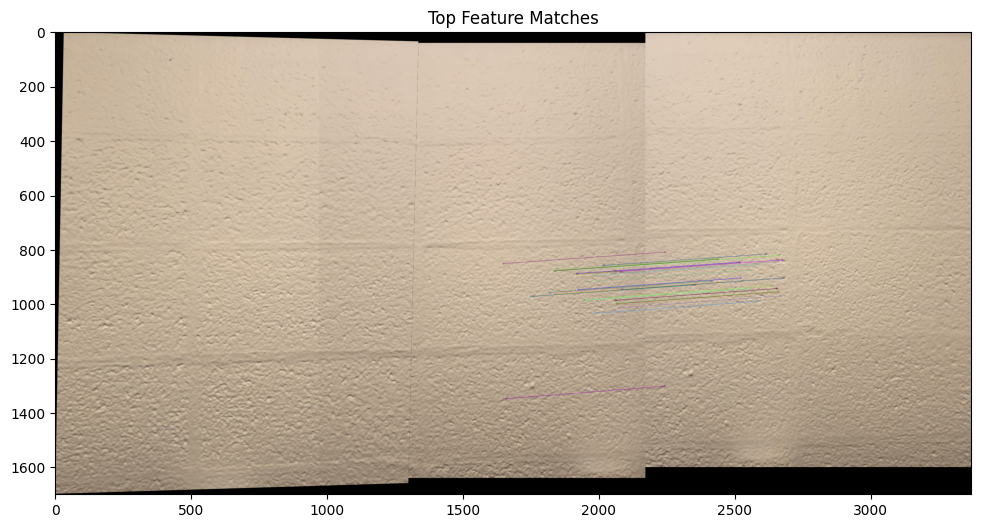

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 80


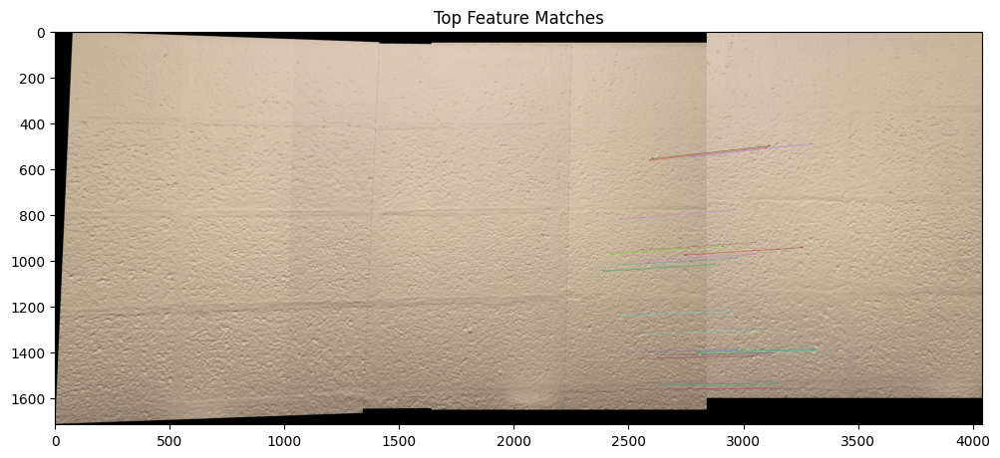

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 89


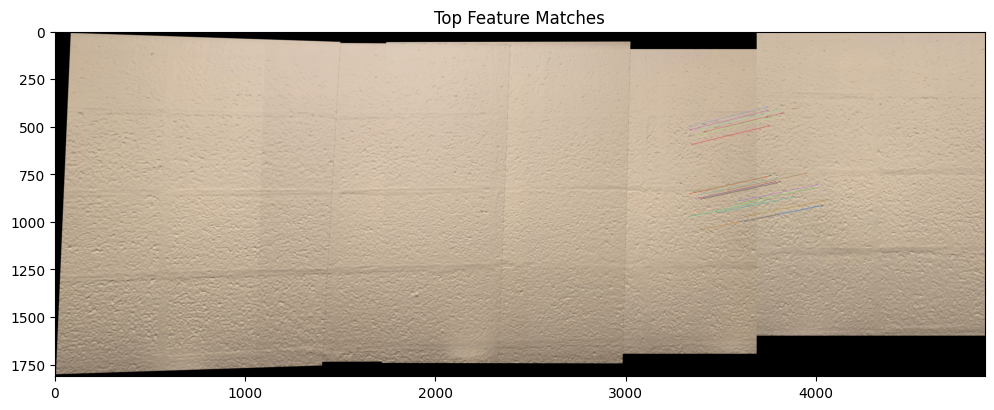

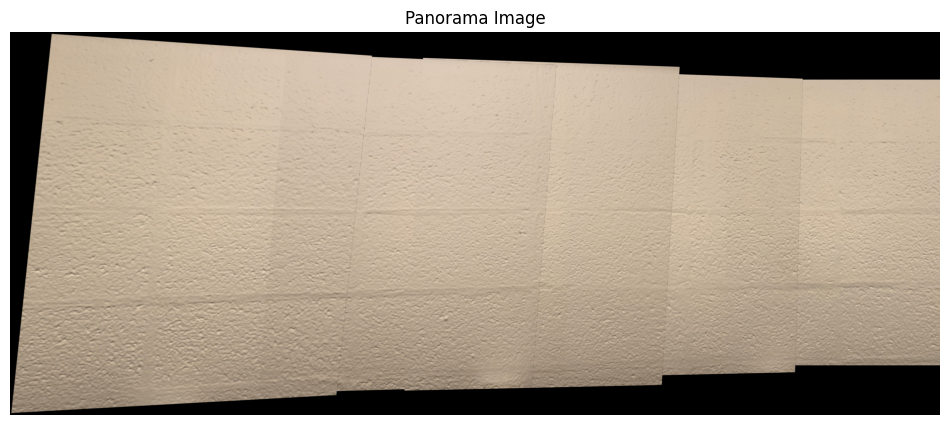

In [18]:
panorama_4 = create_panorama(images_4)

# Display the final panorama
plt.figure(figsize=(12, 10))
plt.imshow(panorama_4)
plt.title("Panorama Image")
plt.axis("off")
plt.show()

## 15% Overlap

Images loaded successfully!


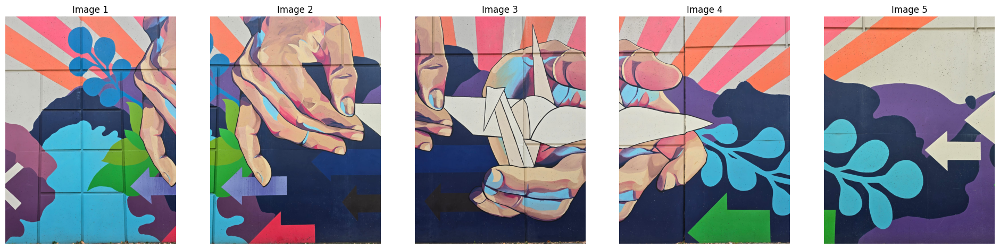

In [19]:
path_5 = "/home/sairam/Desktop/RSN/HW-ASST/ASSIGNMENTS/LAB5/15% Overlap/"
images_5 = load_images(path_5)

Stitching image 0 and 1...


/tmp/ipykernel_18766/2371825414.py:61: RuntimeWarning: invalid value encountered in sqrt
  sqrt_term = np.sqrt(B**2 - 4*(IxIx * IyIy - IxIy**2))


Number of good matches between stitched image and image 1: 265


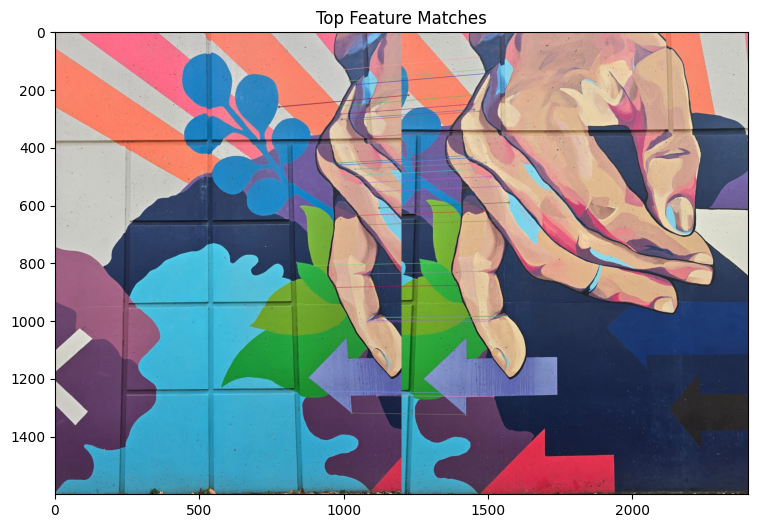

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 163


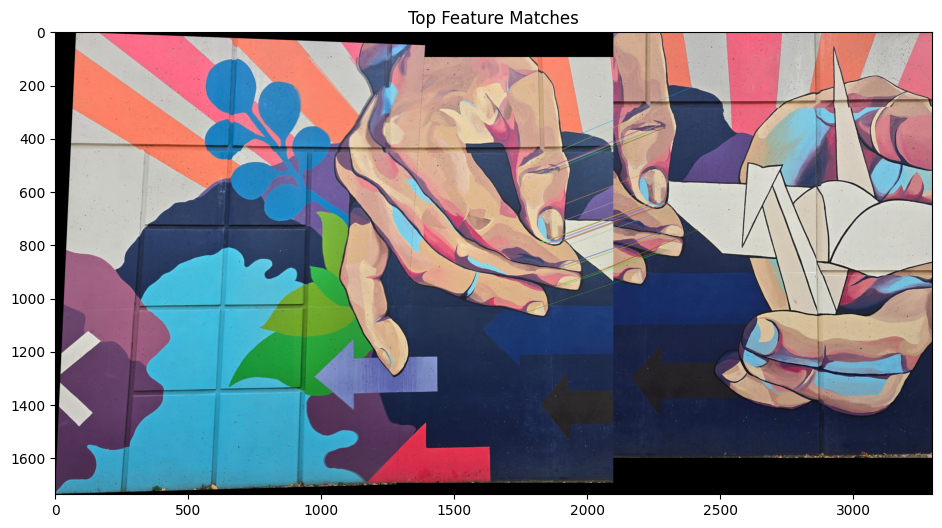

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 141


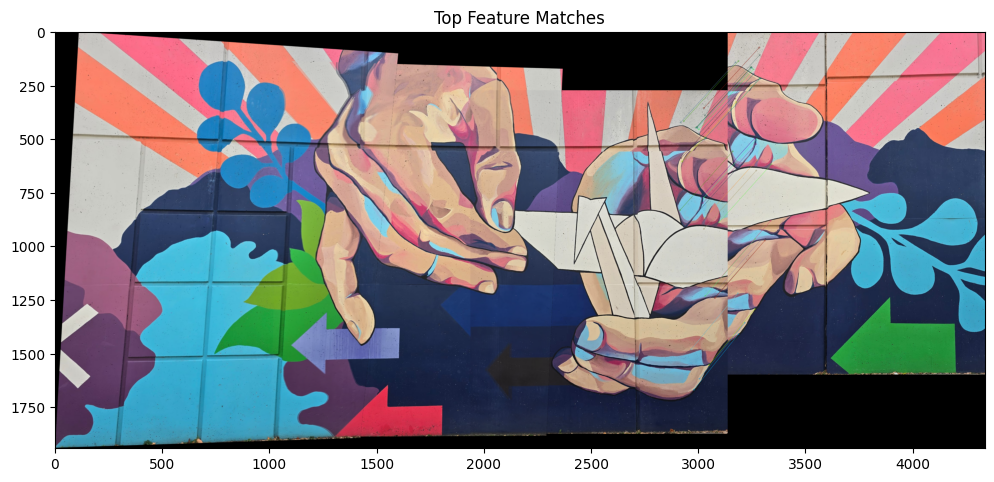

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 78


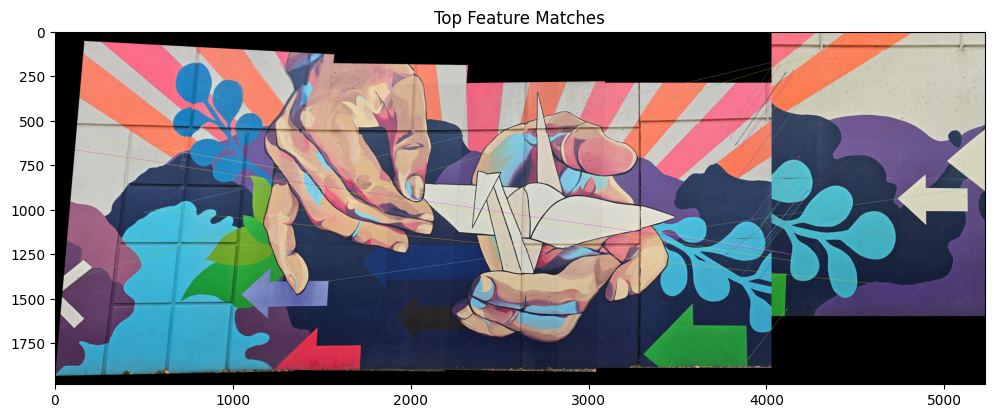

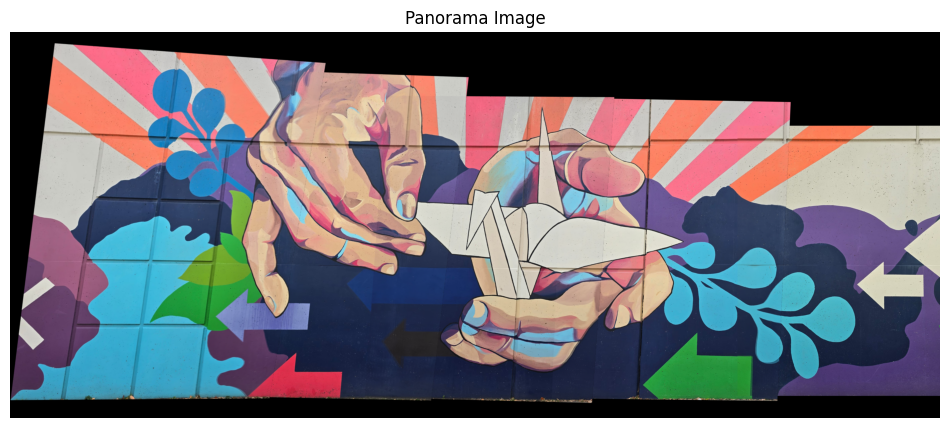

In [20]:
panorama_5 = create_panorama(images_5)

# Display the final panorama
plt.figure(figsize=(12, 10))
plt.imshow(panorama_5)
plt.title("Panorama Image")
plt.axis("off")
plt.show()

### The mosaicing algorithm works well even for the 15% overlap data set. I made common changes in the Harris corner detection parameters, for all the image sets as mentioned above

# CONCLUSION:

The panorama stitching algorithm successfully produced the desired panoramic images across different scenarios, demonstrating the robustness of the feature detection and matching techniques employed. The keypoints were detected using Harris corner detectors, and the feature descriptors were formulated from SIFT (Scale-Invariant Feature Transform). The Opencv provided us with all the requirements for this Lab assignment.

### >50% Overlapping Mural Images:
The high degree of overlap and distinct, well-defined features in the mural allowed for accurate feature detection and matching by the algorithm.

### >50% Overlapping Wall Images:
Despite the uniform texture and repetitive patterns in the wall images, the algorithm managed to align the images effectively because it was able to detect the less distinct features, like cracks and holes in the wall images and matched them to form the panorama.

### <15% Overlapping Mural Images:
This scenario had minimal overlap, making feature detection and matching significantly harder. Despite the limited overlapping region, the algorithm still produced a reasonable panorama. The parameter adjustment in the harris corner detection was a lot helpful in this case.
(N = 1500 and tile